The **Lecture slides** can be found [here](https://github.com/GDSL-UL/wma/raw/main/lectures/w09.pdf).

This **lab**'s notebook can be downloaded from [here](https://github.com/GDSL-UL/wma/blob/main/labs/w09_advanced.ipynb).

In [1]:
## check if those are installed
# pip install geoviews
# pip install movingpandas

In [1]:
import pandas as pd, geopandas as gpd
import movingpandas as mpd

import os
from shapely.geometry import Point, LineString, Polygon
from matplotlib import pyplot as plt
import movingpandas as mpd

import folium
import requests
from io import BytesIO

import warnings
warnings.filterwarnings('ignore')

## Getting GPS trajectories from OpenStreetMap Data 

The OSM API provides access to GPS traces contributed by the OpenStreetMap community. Users can query and retrieve traces based on parameters like geographical bounding box, time range, and user ID. The API supports output formats such as GPX for easy integration into applications or analysis. You can have a look at the last GPS traces uploaded [here](https://www.openstreetmap.org/traces). Each trace entry likely includes:

- Trace ID (unique identifier for the trace)
- Trace Name (optional name provided by the user)
- Uploader Username
- Upload Date
- Trace Summary (e.g., distance, duration)

It's not possible to download traces from OSM using `OSMnx`. One has to script their own code

Parts of this section of the notebook have been readapted from this [notebook](https://github.com/movingpandas/movingpandas-examples/blob/main/2-analysis-examples/osm-traces.ipynb) created by Anita Graser.

### Downaloding GPS traces from the OpenStreetMap

We can try to get OSM traces around the Uni of Liverpool Campus. Feel free to change the area.

In [2]:
import osmnx as ox
# Define the place name
place_name = "University of Liverpool, UK"

# Get the latitude and longitude
latitude, longitude = ox.geocoder.geocode(place_name)

# Create the bbox
bbox = ox.utils_geo.bbox_from_point((latitude, longitude), dist = 1500)
bbox

(53.420732655032396,
 53.39375304496761,
 -2.9432044446907044,
 -2.988462877347038)

We need the `bbox_to_osm_format` function below to convert our bounding box coordinates into the format required by the OpenStreetMap (OSM) API. The input tuple contains coordinates in the order (north, south, east, west). The function rearranges these values into the string "west,south,east,north", which is the format expected by OSM for API queries. 

In [3]:
def bbox_to_osm_format(bbox):
    """
    Convert bounding box coordinates to OSM API format.

    Parameters
    ----------
    bbox: tuple
        A tuple containing the bounding box coordinates in the order (north, south, east, west).

    Returns
    -------
    bbox_str: str
        A string representing the bounding box in the format "west,south,east,north".
    """
    north, south, east, west = bbox
    bbox = f"{west},{south},{east},{north}"
    return bbox

In [4]:
bbox = bbox_to_osm_format(bbox) # needs to be {west},{south},{east},{north} for OSM Api
bbox

'-2.988462877347038,53.39375304496761,-2.9432044446907044,53.420732655032396'

The `get_osm_traces` function below retrieves GPS traces from OpenStreetMap within a specified bounding box, processing up to a user-defined maximum number of pages. It uses a while loop to fetch and parse GPS data into GeoDataFrames, querying the OSM API by incrementally updating the page number until no more data is available or the maximum page limit is reached.

Upon fetching the data, the function concatenates these individual GeoDataFrames into a single comprehensive GeoDataFrame. Before returning the final GeoDataFrame, it cleans the dataset by dropping a predefined list of potentially irrelevant or empty columns.

In [5]:
def get_osm_traces(max_pages = 2,  bbox='16.18, 48.09, 16.61, 48.32'):
    """
    Retrieve OpenStreetMap GPS traces within a specified bounding box.

    Parameters
    ----------
    max_pages: int, optional
        The maximum number of pages to retrieve. Defaults to 2.
    bbox: str, optional
        The bounding box coordinates in the format 'west, south, east, north'. Defaults to '16.18, 48.09, 16.61, 48.32'.

    Returns
    -------
    final_gdf: GeoDataFrame
        A GeoDataFrame containing the retrieved GPS traces.
    """
    
    all_data = []
    page = 0
    
    while (True) and (page <= max_pages):
        # Constructing the URL to query OpenStreetMap API for GPS trackpoints within a specified bounding box and page number
        url = f'https://api.openstreetmap.org/api/0.6/trackpoints?bbox={bbox}&page={page}'
        
        # Sending a GET request to the constructed URL
        response = requests.get(url)
        
        # Checking if the response status code is not 200 (indicating success) or if the response content is empty
        # If either condition is met, the loop breaks, indicating no more data to retrieve
        if response.status_code != 200 or not response.content:
            break
        
        # Reading the content of the response, which contains GPS trackpoints data, into a GeoDataFrame
        # The 'layer' parameter specifies the layer within the GeoDataFrame where trackpoints will be stored
        gdf = gpd.read_file(BytesIO(response.content), layer='track_points')

        if gdf.empty:
            break
            
        all_data.append(gdf)
        page += 1
        
    # Concatenate all GeoDataFrames into one
    final_gdf = gpd.GeoDataFrame(pd.concat(all_data, ignore_index=True))
    
    # dropping empty columns
    columns_to_drop = ['ele', 'course', 'speed', 'magvar', 'geoidheight', 'name', 'cmt', 'desc',
                       'src', 'url', 'urlname', 'sym', 'type', 'fix', 'sat', 'hdop', 'vdop',
                       'pdop', 'ageofdgpsdata', 'dgpsid']
    
    final_gdf = final_gdf.drop(columns=[col for col in columns_to_drop if col in final_gdf.columns])
    return final_gdf

We initially download 2 pages of GSP traces. We can try with higher numbers to get more data. More recent traces are downloaded first.

In [6]:
max_pages = 2 # pages of data, 
gps_track_points = get_osm_traces(max_pages, bbox)

In [7]:
gps_track_points.head()

,track_fid,track_seg_id,track_seg_point_id,time,geometry
0,0,0,0,2023-09-24 10:41:39+00:00,POINT (-2.98825 53.40690)
1,0,0,1,2023-09-24 10:41:46+00:00,POINT (-2.98793 53.40708)
2,0,0,2,2023-09-24 10:41:47+00:00,POINT (-2.98408 53.40931)
3,0,0,3,2023-09-24 10:41:49+00:00,POINT (-2.98391 53.40927)
4,0,0,4,2023-09-24 10:41:50+00:00,POINT (-2.98378 53.40933)


<Axes: >

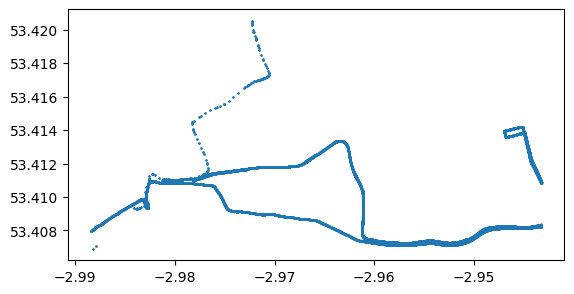

In [8]:
gps_track_points.plot(markersize = 0.5) # still are trackpoints still

### Transform the `Point` GeoDataFrame in a `LineString` GeoDataFrame with `MovingPandas`

`MovingPandas` is a Python library designed for analyzing movement data using `Pandas`. It extends `Pandas`' capabilities to handle temporal and spatial data jointly. It is the ideal library for trajectory data analysis, visualization, and exploration. MovingPandas provides functionalities for processing and analyzing movement data, including trajectory segmentation, trajectory aggregation, and trajectory generalization.

**See examples and documentation at https://movingpandas.org**

The following code creates a `TrajectoryCollection` object by providing the GPS track points data, specifying the column that identifies trajectories, and indicating the column containing timestamps.

In [9]:
osm_traces = mpd.TrajectoryCollection(gps_track_points, 'track_fid', t='time')
print(f'The OSM traces download contains {len(osm_traces)} tracks')

The OSM traces download contains 14 tracks


In [10]:
for track in osm_traces: 
    print(f'Track {track.id}: length={track.get_length(units="km"):.2f} km')

Track 0: length=9.96 km
Track 1: length=3.02 km
Track 2: length=2.84 km
Track 3: length=2.72 km
Track 4: length=2.92 km
Track 5: length=3.29 km
Track 6: length=4.95 km
Track 7: length=4.12 km
Track 8: length=4.87 km
Track 9: length=1.21 km
Track 10: length=0.03 km
Track 11: length=0.00 km
Track 12: length=0.70 km
Track 13: length=0.36 km


Below we set up some visualization options for `holoviews`. Holoviews is a library for creating interactive visualizations of complex datasets with ease. Holoviews provides a declarative approach to building visualizations, allowing you to express your visualization intent concisely. Holoviews combines the usage of Matplotlib, Bokeh, and Plotly and supports creating interactive visualizations. You can easily add interactive elements like hover tooltips, zooming, panning, and selection widgets to your plots. Compared to `folium`, however, it does not allow for as much freedom and development outside the box. Folium is primarily designed for creating web-based maps with features like tile layers and GeoJSON overlays, offering a high degree of customization for map-based visualizations. Holoviews, on the other hand, focuses more on general-purpose interactive visualizations beyond just maps, offering a broader range of visualization options. 

See examples and documentation at https://holoviews.org.

In [11]:
from holoviews import opts, dim
import hvplot.pandas 

plot_defaults = {'linewidth':5, 'capstyle':'round', 'figsize':(9,3), 'legend':True}
opts.defaults(opts.Overlay(active_tools=['wheel_zoom'], frame_width=500, frame_height=400))
hvplot_defaults = {'tiles':None, 'cmap':'Viridis', 'colorbar':True}

**Traces generalisation**

The `MinTimeDeltaGeneralizer` class from MovingPandas is applied to the `osm_traces` object. This class is responsible for simplifying or generalizing the GPS traces based on a minimum time delta. In this case, traces are being generalized to a tolerance of one minute.

In [12]:
from datetime import datetime, timedelta
osm_traces = mpd.MinTimeDeltaGeneralizer(osm_traces).generalize(tolerance=timedelta(minutes=1))
osm_traces.hvplot(title='OSM Traces', line_width=3, width=700, height=400)

:Overlay
   .WMTS.I      :WMTS   [Longitude,Latitude]
   .Path.I      :Path   [Longitude,Latitude]
   .Path.II     :Path   [Longitude,Latitude]
   .Path.III    :Path   [Longitude,Latitude]
   .Path.IV     :Path   [Longitude,Latitude]
   .Path.V      :Path   [Longitude,Latitude]
   .Path.VI     :Path   [Longitude,Latitude]
   .Path.VII    :Path   [Longitude,Latitude]
   .Path.VIII   :Path   [Longitude,Latitude]
   .Path.IX     :Path   [Longitude,Latitude]
   .Path.X      :Path   [Longitude,Latitude]
   .Path.XI     :Path   [Longitude,Latitude]
   .Path.XII    :Path   [Longitude,Latitude]
   .Path.XIII   :Path   [Longitude,Latitude]
   .Path.XIV    :Path   [Longitude,Latitude]
   .Points.I    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.II   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.III  :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.IV   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.V    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VI   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VII  :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VIII :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.IX   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.X    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XI   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XII  :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XIII :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XIV  :Points   [Longitude,Latitude]   (triangle_angle)

Visualising by speed

In [13]:
osm_traces.get_trajectory(0).add_speed(overwrite=True, units=("km","h"))
osm_traces.get_trajectory(0).hvplot(
    title='Speed (km/h) along track', c='speed', cmap='RdYlBu',
    line_width=3, width=700, height=400, tiles='CartoLight', colorbar=True)

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Path.I   :Path   [Longitude,Latitude]   (speed)
   .Points.I :Points   [Longitude,Latitude]   (speed,triangle_angle)

One can also convert the `TrajectoryCollection` (MovingPandas' object) to a LineString `GeoDataFrame`. 
This would allow us to take advantage of what we learnt across the previous sessions. For example, we can plot through `GeoPandas` and `matplotlib` after having projected the layer.

<Axes: >

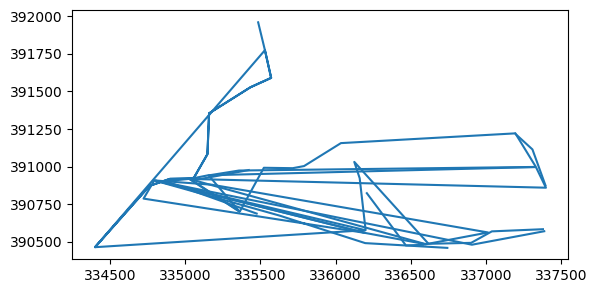

In [14]:
crs = 'EPSG:27700'
gps_tracks = osm_traces.to_traj_gdf()
gps_tracks = gps_tracks.set_crs("EPSG:4326").to_crs(crs)

As you can see, from the map above, OSM traces may include also odd traces that jump from different locations of the city.

<div class="alert alert-success">

**Exercise**:
Explore the `gps_tracks` dataset and try to compute the average speed of each of the tracks.
Try to understand, also using the `gps_track_points` (do not forget to project it, in case), if you can find a way to filter out traces that follow very odd routes.
    
</div>

## Animations in Folium
### Animating GPS tracks

In [15]:
from folium.plugins import TimestampedGeoJson

Download this [file]("https://github.com/GDSL-UL/wma/blob/main/data/geolife_small.gpkg") in your data folder.

<Axes: >

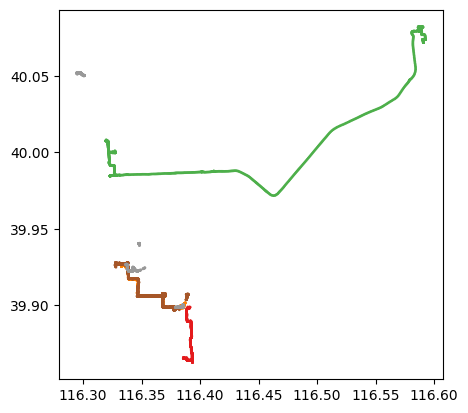

In [16]:
gdf = gpd.read_file('../data/geolife_small.gpkg')
gdf['t'] = pd.to_datetime(gdf['t'])
gdf = gdf.set_index('t').tz_localize(None)
gdf.index.name = None
gdf.plot(column = 'trajectory_id', markersize = 1, cmap = 'Set1')

- `gdf['t'] = pd.to_datetime(gdf['t'])`: This converts the values in the 't' column of `gdf` into datetime objects using `pd.to_datetime()`. This is useful for time-series data where 't' likely represents time information.
- `gdf = df.set_index('t').tz_localize(None)`: This sets the index to the column `t` and removes the timezone information using `tz_localize(None)`

In [19]:
def geo_df_to_timestamped_geojson(geo_df, colour="blue", marker_type="LineString"):
    """
    Convert a GeoDataFrame to a list of timestamped GeoJSON features.

    Parameters
    ----------
        geo_df: GeoDataFrame
            The GeoDataFrame containing the geographic data.
        colour:str
            The color of the line or marker. Defaults to "blue".
        marker_type: str
            The type of marker to use, e.g., "LineString" or "Point". Defaults to "LineString".

    Returns
    -------
        feature_list: list
            A list of GeoJSON features, each representing a timestamped marker or line.
    """

    df = geo_df.copy()
    x_coords = df["geometry"].x.to_list()
    y_coords = df["geometry"].y.to_list()
    coordinate_list = [[x, y] for x, y in zip(x_coords, y_coords)]
    times_list = [i.isoformat() for i in df.index.to_list()]
    
    feature_list = [
       {
           "type": "Feature",
           "geometry": {
               "type": marker_type,
               "coordinates": coordinate_list,
           },
           "properties": {
               "times": times_list,
               "style": {
                   "color": colour,
                   "weight": 3,
               },
           },
       }
    ]
    
    return feature_list

Obtaining features from the `GeoDataFrame` so that we can plot them in `folium` directly.

In [20]:
features = geo_df_to_timestamped_geojson(gdf, colour="blue", marker_type="LineString")

This `TimestampedGeoJson` plugin allows us to draw data on an interactive folium map and animate it depending on a time variable (year, month, day, hour, etc) and supports any kind of geometry (points, line strings, etc). The only thing you have to do is to make sure to "feed" it with a geojson in the right format.

In [36]:
xy = gdf.unary_union.centroid
map = folium.Map(location=[xy.y, xy.x], zoom_start=10)

TimestampedGeoJson({"type": "FeatureCollection", "features": features},
    period="PT1S",
    add_last_point=True,
    transition_time=10
).add_to(map)

map

The arguments of the `TimestampedGeoJson` plugin are:

- The geojson with the data.
- `period`: It is the time step that the animation will take starting from the first value. For example: "P1M" 1/month, "P1D" 1/day, "PT1H" 1/hour, and ‘PT1M’ 1/minute.
- `duration`: Period of time which the features will be shown on the map after their time has passed. If None, all previous times will be shown.

### Other Animations with Folium

This part of the notebook has been readapted from this [post](https://www.linkedin.com/pulse/visualizing-nyc-bike-data-interactive-animated-maps-folium-toso/).

We are going to use the data of New York's Citi Bike-sharing service. This is publicly available and can be downloaded from [here](https://s3.amazonaws.com/tripdata/index.html). In this notebook, we used the data for the month of March 2024. Place it in your data folder, you can download it from [here](https://github.com/GDSL-UL/wma/blob/main/data/NY_march_bikeData.csv).

In [23]:
# Import the file as a Pandas DataFrame
nyc = pd.read_csv("../data/NY_march_bikeData.csv")
nyc.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,9F5EEFB7CF78C6EA,electric_bike,2024-03-21 13:32:42,2024-03-21 13:35:42,Stevens - River Ter & 6 St,HB602,City Hall - Washington St & 1 St,HB105,40.743143,-74.026907,40.737360,-74.030970,member
1,01E2E1F218F9D303,electric_bike,2024-03-16 08:26:15,2024-03-16 08:47:53,Pershing Field,JC024,Pershing Field,JC024,40.742379,-74.051996,40.742677,-74.051789,member
2,C2914D662B33AA55,electric_bike,2024-03-15 15:17:36,2024-03-15 15:32:12,Pershing Field,JC024,Pershing Field,JC024,40.742480,-74.051942,40.742677,-74.051789,member
3,6723F7CE51888493,electric_bike,2024-03-13 08:34:26,2024-03-13 08:50:08,Pershing Field,JC024,Pershing Field,JC024,40.742400,-74.051963,40.742677,-74.051789,member
4,EAB7E29AAB546941,electric_bike,2024-03-15 15:37:58,2024-03-15 16:19:32,Pershing Field,JC024,Pershing Field,JC024,40.742459,-74.051973,40.742677,-74.051789,member


For every trip made we have:

- `started_at`: start date and time of the trip.
- `ended_at`: end date and time the trip.
- `start_station_id`, `start_station_name`, `start_lat`, and `start_lng`: all the useful info to identify and locate the start station.
- `end_station_id`, `end_station_name`, `end_lat`, and `end_lng`: all the useful info to identify and locate the end station of the trip.

In [24]:
type(nyc.loc[0, 'started_at'])

str

**Transformation**

The variables `started_at` and `ended_at` were imported as text (string). we are going to do the following:

- Change the type of these variables to datetime.
- Compute the duration of the trip in seconds.
- Define `started_at` as the data frame's index. This will allow us to pivot (group) values easier by time of day.
- Create a new column called `ty` to help us in the pivoting.

In [25]:
# Setting the right format for started_at and ended_at
nyc['started_at'] = pd.to_datetime(nyc['started_at'])
nyc['ended_at'] = pd.to_datetime(nyc['ended_at'])
nyc['duration'] = (nyc['ended_at'] - nyc['started_at']).dt.total_seconds()

# Define the startime as index and create a new column
nyc = nyc.set_index('started_at')
nyc['ty'] = 'station'
nyc.head(1)

,ride_id,rideable_type,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,duration,ty
started_at,,,,,,,,,,,,,,
2024-03-21 13:32:42,9F5EEFB7CF78C6EA,electric_bike,2024-03-21 13:35:42,Stevens - River Ter & 6 St,HB602,City Hall - Washington St & 1 St,HB105,40.743143,-74.026907,40.73736,-74.03097,member,180.0,station


Now, we need to feed TimestampedGeoJson plugin with the right data format. To do so, we will transform the data frame. First, we count the number of trips per hour that start at each station

In [26]:
# Aggregate number of trips for each start station by hour of the day
start = nyc.pivot_table('duration', 
                     index = ['start_station_id', 
                              'start_lat', 
                              'start_lng', 
                              nyc.index.hour],
                     columns = 'ty',
                     aggfunc='count').reset_index()

start.head()

ty,start_station_id,start_lat,start_lng,started_at,station
0,6786.02,40.714002,-74.093255,12,1
1,6839.10,40.714002,-74.093255,17,1
2,6948.10,40.714002,-74.093255,14,1
3,6955.05,40.714002,-74.093255,12,1
4,7141.07,40.714002,-74.093255,16,1


In the code above we use the pandas `pivot_table()` to group the data. Note that the last index we use is "nyc.index.hour". This takes the index of the data frame and, since it is of the datetime format, we can get the hour of that value like shown above. Similarly, we could get the day or month. Thus, to get a daily average we will divide by the numbers of days.

In [27]:
days = nyc.index.day.max()
start['station'] = start['station']/days

Now, we will change the name of the columns and define the color we want the points to have on the map.

In [28]:
# Rename the columns
start.columns = ['station_id', 'lat', 'lon', 'hour', 'count']

# Define the color
start['fillColor'] = '#53c688'

# The stops where less than one daily trip
# will have a different color
start.loc[start['count']<1, 'fillColor'] = '#586065'
start.head(1)

,station_id,lat,lon,hour,count,fillColor
0,6786.02,40.714002,-74.093255,12,0.032258,#586065


After transforming the data frame to the format we need, we have to define a function that takes the values from it and creates the geojson with the right properties to use in the plugin.

In [29]:
def create_geojson_features(df):
    features = []
    
    for _, row in df.iterrows():
        feature = {
            'type': 'Feature',
            'geometry': {
                'type':'Point', 
                'coordinates':[row['lon'],row['lat']]
            },
            'properties': {
                'time': pd.to_datetime(row['hour'], unit='h').__str__(),
                'style': {'color' : ''},
                'icon': 'circle',
                'iconstyle':{
                    'fillColor': row['fillColor'],
                    'fillOpacity': 0.8,
                    'stroke': 'true',
                    'radius': row['count'] + 5
                }
            }
        }
        features.append(feature)
   
    return features

The function:

- Takes a data frame and iterates through its rows.
- Creates a feature and defines the geometry as a point, taking the lat and lon variables from our data frame.
- Defines the rest of the properties taking the other variables:
    1. Takes the hour variable to create a time property. ** This one is the most important step to animate our data. **
    1. Takes `fillColor` to create the fillColor property.
    1. Defines the radius of the point as a function of the count variable.

Once the function is defined, we can use it on our data frame and get the geojson.

In [30]:
start_geojson = create_geojson_features(start)
start_geojson[0]

{'type': 'Feature',
 'geometry': {'type': 'Point',
  'coordinates': [-74.0932553, 40.714001716666665]},
 'properties': {'time': '1970-01-01 12:00:00',
  'style': {'color': ''},
  'icon': 'circle',
  'iconstyle': {'fillColor': '#586065',
   'fillOpacity': 0.8,
   'stroke': 'true',
   'radius': 5.032258064516129}}}

With this, we can now create the animated map.

In [31]:
nyc_map = folium.Map(location = [40.71958611647166, -74.0431174635887],
                    tiles = "CartoDB Positron",
                    zoom_start = 14)

TimestampedGeoJson(start_geojson,
                  period = 'PT1H',
                  duration = 'PT1M',
                  transition_time = 1000,
                  auto_play = True).add_to(nyc_map)

nyc_map

It might be a good idea to analyze where trips end at different times of the day. Even more, it could be interesting to see both maps side by side and try to identify a pattern.

The DualMap plugin can help us achieve this. To use it, we will first run a similar script to the one we did above to get the number of trips that end at each station by time of the day.

In [32]:
nyc1 = nyc.reset_index().set_index('ended_at')
end = nyc1.pivot_table('duration', 
                     index = ['end_station_id', 
                              'end_lat', 
                              'end_lng', 
                              nyc1.index.hour],
                     columns = 'ty',
                     aggfunc='count').reset_index()

end['station'] = end['station']/days

end.columns = ['station_id', 'lat', 'lon', 'hour', 'count']
end['fillColor'] = '#e64c4e'
end.loc[end['count']<1, 'fillColor'] = '#586065'
end_geojson = create_geojson_features(end)

We first create the dual map and then we add start_geojson to the left map (m1) and the end_geojson to the right map (m2).

In [33]:
from folium.plugins import DualMap

dualmap = DualMap(location = [40.71958611647166, -74.0431174635887],
                 tiles = 'cartodbpositron',
                 zoom_start = 14)

TimestampedGeoJson(start_geojson,
                  period = 'PT1H',
                  duration = 'PT1M',
                  transition_time = 1000,
                  auto_play = True).add_to(dualmap.m1)

TimestampedGeoJson(end_geojson,
                  period = 'PT1H',
                  duration = 'PT1M',
                  transition_time = 1000,
                  auto_play = True).add_to(dualmap.m2)

dualmap

Another interesting plugin, `HeatmapWithTime`, allows animating heatmaps. According to the documentation, the input needs to be a list of lists:

"data (*list of lists of points of the form [lat, lng] or [lat, lng, weight]*) – The points you want to plot. The outer list corresponds to the various time steps in sequential order. (weight is in (0, 1] range and defaults to 1 if not specified for a point)" 

Therefore, we need to create this list of points for each hour of the day and then put all those lists in a new one.

In [34]:
# Create an empty list
df_hour_list = []

# Create a series with the different hours of the day
hours = pd.Series(nyc.index.hour.unique().sort_values())

# Create a list of points for each hour of the day
def create_list(hour):
    df_hour_list.append(nyc.loc[nyc.index.hour == hour,
                                ['start_lat',
                                 'start_lng']].
                        groupby(['start_lat', 
                                 'start_lng']).sum().reset_index().values.tolist())
hours.apply(create_list);

In [35]:
from folium.plugins import HeatMapWithTime

location = [40.71958611647166, -74.0431174635887]
# Add trip events to the map
map_time = folium.Map(location=location, 
                      tiles="CartoDB Positron", 
                      zoom_start=12)

HeatMapWithTime(df_hour_list, 
                auto_play=True, 
                max_opacity=0.5, 
                gradient = {0.2: '#FBD973', 
                            0.4: '#fa782f', 
                            0.75: '#F16578', 
                            1: '#782890'}).add_to(map_time)
map_time

<div class="alert alert-success">

**Exercise**:

Explore the other `folium` plugins and think which of them could be useful for your last assignment. See: https://python-visualization.github.io/folium/latest/user_guide/plugins.html


If you have time also have a look at [PyDeck](https://deckgl.readthedocs.io/en/latest/).

Pydeck is a Python library used for creating interactive maps and data visualizations. It can be exploited to generate appealing maps with features like scatter plots, line plots, choropleths, and, more importantly, **3D visualisations**. Pydeck is built on top of Deck.gl, a WebGL-powered library for rendering large-scale data visualizations. It offers various customization options for styling and configuring the visualizations and supports integration with `Pandas` and `GeoPandas`.

Pydeck installation is not trivial and can be result in conflicts with other libraries/versions, see: https://deckgl.readthedocs.io/en/latest/installation.html 

**Its usage for the final assignment is optional**.
</div>